In [1]:
import numpy as np
from matplotlib import pyplot as plt
import librosa
import soundfile as sf
from IPython.display import Audio
from matplotlib.colors import ListedColormap
from scipy.signal import butter
from scipy.io import wavfile
from scipy.signal import filtfilt

In [9]:
audio_file = "animals.wav"

signal, sampling_rate = librosa.core.load(audio_file, mono = False)

In [65]:
def getSegment(signal, sampling_rate, start_time, duration):

    end_time = start_time + duration

    start_index = start_time * sampling_rate
    end_index = end_time * sampling_rate

    segment = signal[start_index : end_index]

    return segment

In [66]:
signal = [getSegment(signal, sampling_rate, 0, 10) for signal in signal]

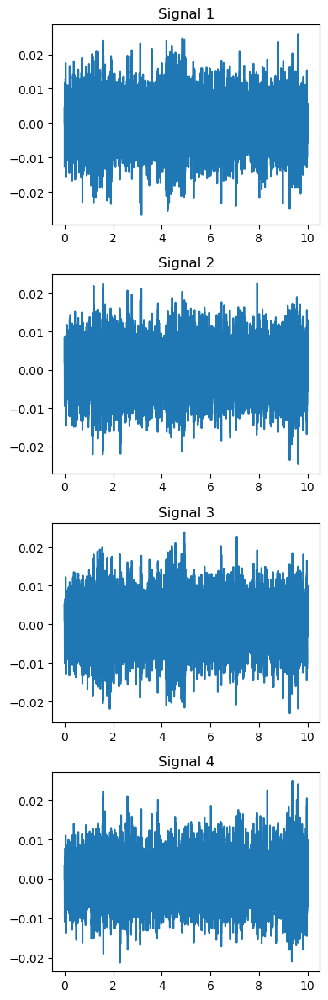

In [67]:
plt.figure(figsize = (4, 12))

for i in range(len(signal)):


    N = len(signal[i])

    t = np.arange(N) * 1/ sampling_rate

    display(Audio(signal, rate = sampling_rate))

    plt.subplot(len(signal), 1, i + 1)

    plt.title("Signal "+ str(i + 1))
    plt.plot(t, signal[i])
    plt.tight_layout()

In [68]:

def makeSpectrogram(signal, sampling_rate, window_size = 512, filter_type = "Hann"):
    N = len(signal)

    if (filter_type == 'Hann'):
        filter = np.hanning(window_size)
    elif (filter_type == 'Bartlet'):
        filter = np.bartlet(window_size)
    elif (filter_type is None):
        filter = np.ones((window_size))

    freqs = np.fft.fftfreq(window_size, 1/sampling_rate)

    t = np.arange(N) * 1/sampling_rate

    inds = np.arange(0, N - window_size, window_size/5)

    spectrogram = np.zeros((len(inds), int(window_size/2)), dtype=complex)

    for i in np.arange(len(inds)):
        s_window = signal[int(inds[i]):int(inds[i] + window_size)] * filter

        fw = np.fft.fft(s_window)

        spectrogram[i, :] = fw[0: int(window_size/2)]

    return [inds/sampling_rate, freqs[0:int(len(freqs)/2)], spectrogram]

In [69]:
def plotSpectrogram(inds, freqs, spectrogram, i, format, fmax = 10000):

    plt.figure(figsize = (10, 4))

    plt.pcolormesh(inds, freqs, spectrogram.T)
    plt.xlabel('Time (sec)', fontsize=14)
    plt.ylabel('Frequency (Hz)', fontsize=14)
    if i == 0:
        plt.title(format + " format Plot", fontsize=16)
    plt.ylim([0, fmax])
    plt.colorbar()

    plt.tight_layout()
    plt.show()

In [70]:
def logTransform(spec, scale=10**(-2)):
    return 20 * np.log10(spec + scale * np.ones(spec.shape))

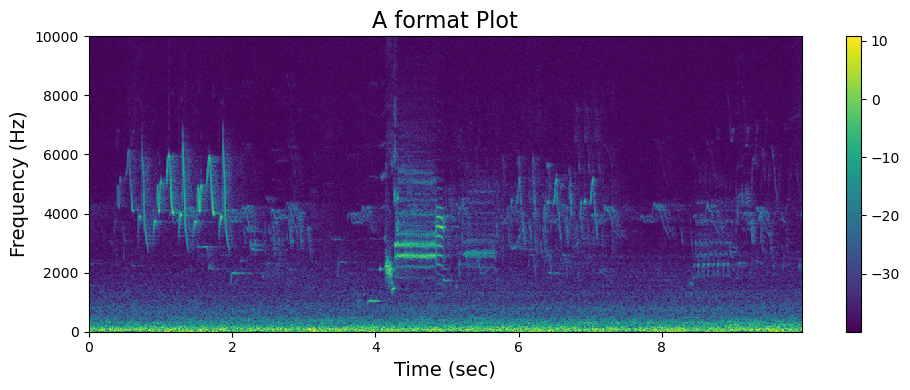

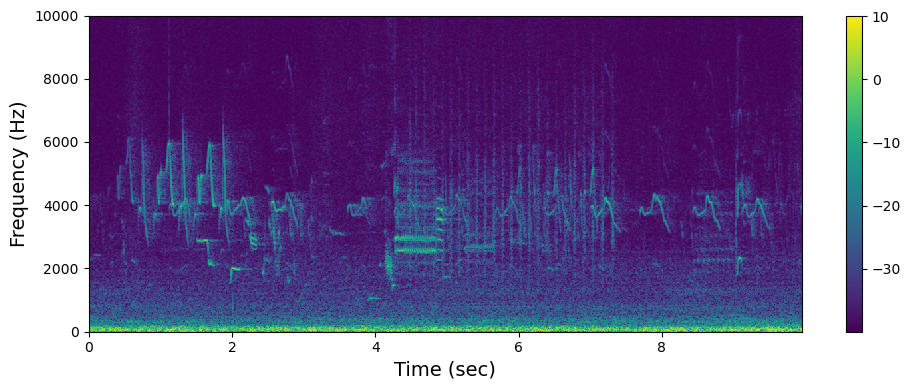

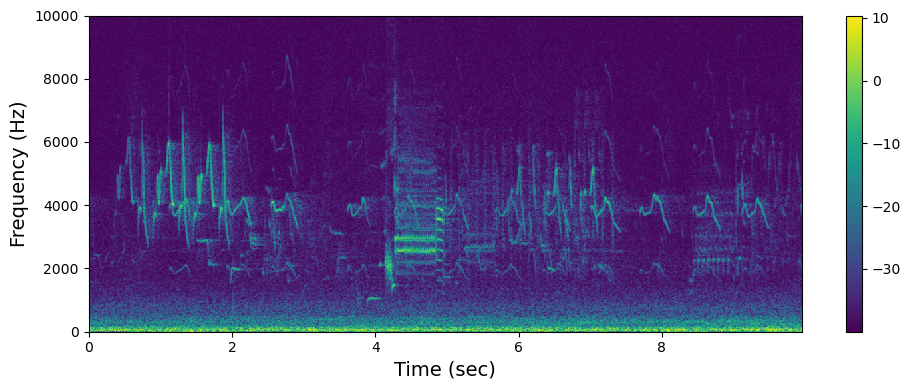

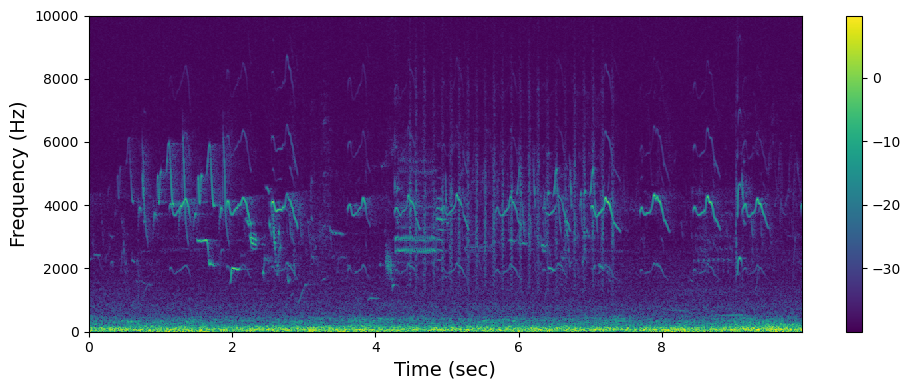

In [71]:
for i in range(len(signal)):
    [inds, freqs, spectrogram] = makeSpectrogram(signal[i], sampling_rate, window_size = 1024)
    plotSpectrogram(inds, freqs, logTransform(np.abs(spectrogram)), i, "A")

In [72]:
def formatConverter(signal):

    conversion_matrix = np.array([
        [1,1,1,1],
        [1,1,-1,-1],
        [1,-1,1,-1],
        [1,-1,-1,1]
    ])

    b_format = np.dot(conversion_matrix, signal)

    return b_format

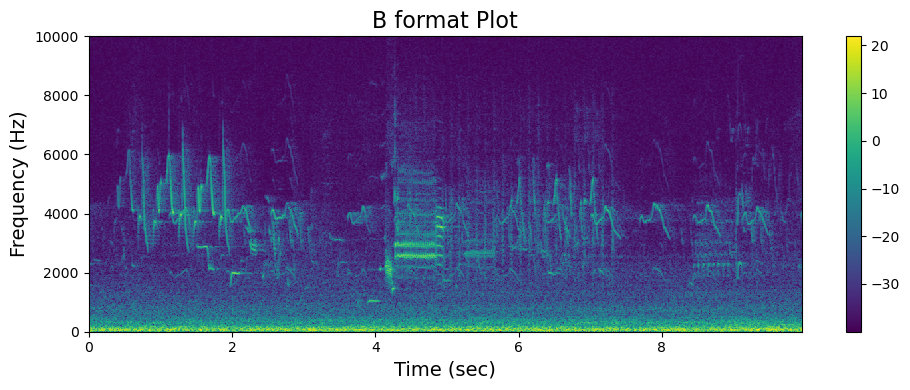

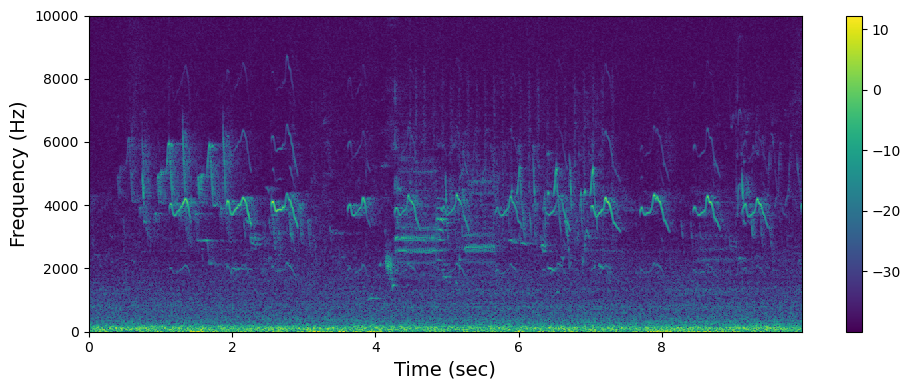

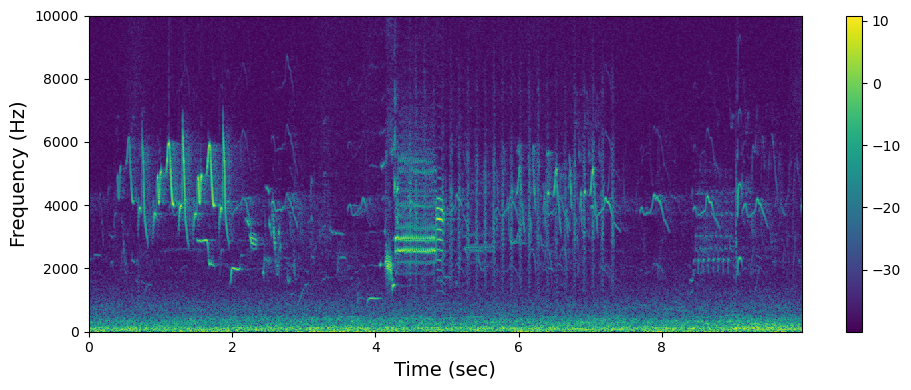

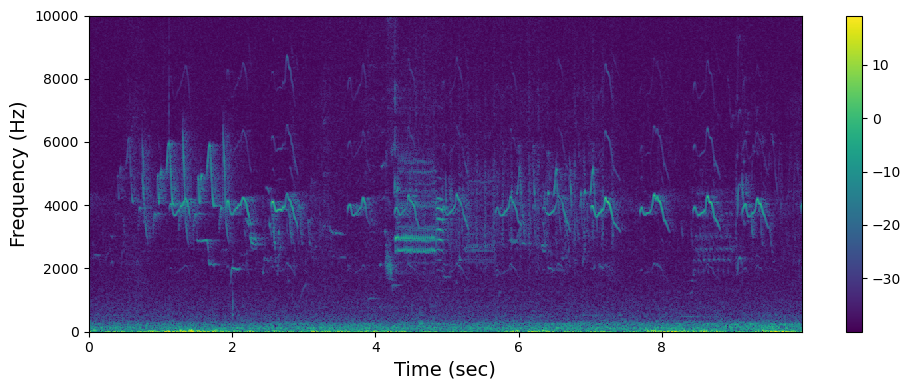

In [73]:
b_signal = formatConverter(signal)
display(Audio(b_signal, rate=sampling_rate))
for i in range(len(b_signal)):
    [inds, freqs, spectrogram] = makeSpectrogram(b_signal[i], sampling_rate, window_size = 1024)
    plotSpectrogram(inds, freqs, logTransform(np.abs(spectrogram)), i, "B")

In [74]:
def generateAzimuth(x, y):
    return np.degrees(np.arctan2(y,x))

In [75]:
def generateElevation(x, y, z):
    return np.degrees(np.arctan2(z, np.sqrt((x**2)+(y**2))))

In [76]:
def generateIntensity(signal):

    [inds, w_freqs, w_spectrogram] = makeSpectrogram(b_signal[0], sampling_rate, window_size = 1024)
    [inds, x_freqs, x_spectrogram] = makeSpectrogram(b_signal[1], sampling_rate, window_size = 1024)
    [inds, y_freqs, y_spectrogram]  = makeSpectrogram(b_signal[2], sampling_rate, window_size = 1024)
    [inds, z_freqs, z_spectrogram]  = makeSpectrogram(b_signal[3], sampling_rate, window_size = 1024)

    w_conjugate = np.conjugate(w_spectrogram)
    intensity = []
    x_intensity = np.real(w_conjugate * x_spectrogram)
    y_intensity = np.real(w_conjugate * y_spectrogram)
    z_intensity = np.real(w_conjugate * z_spectrogram)

    intensity.append(x_intensity)
    intensity.append(y_intensity)
    intensity.append(z_intensity)

    return intensity

In [77]:
intensity = generateIntensity(b_signal)

azimuth = generateAzimuth(intensity[0], intensity[1])

elevation = generateElevation(intensity[0], intensity[1], intensity[2])


In [78]:
def plotAzigram(inds, freqs, azimuth):

    plt.figure(figsize = (10, 4))

    plt.pcolormesh(inds, freqs, azimuth.T, cmap='hsv')
    plt.xlabel('Time (sec)', fontsize=14)
    plt.ylabel('Frequency (Hz)', fontsize=14)
    plt.title("Azigram ", fontsize=16)
    plt.ylim([0, 10000])
    plt.xlim([0, 5])
    plt.colorbar()

    plt.tight_layout()
    plt.show()

In [79]:
def plotElevationAgainstAzigram(elevation, azigram):
    plt.figure(figsize = (20, 8))

    plt.hist2d(azigram.ravel(), elevation.ravel(), bins= 512)
    plt.xlabel("Azimuth")
    plt.ylabel("Elevation")
    plt.ylim([-90, 90])

    # plt.tight_layout()
    plt.show()

In [80]:
[inds, w_freqs, w_spectrogram] = makeSpectrogram(b_signal[0], sampling_rate, window_size = 1024)
p_component = np.abs(w_spectrogram)
p_component = p_component**2

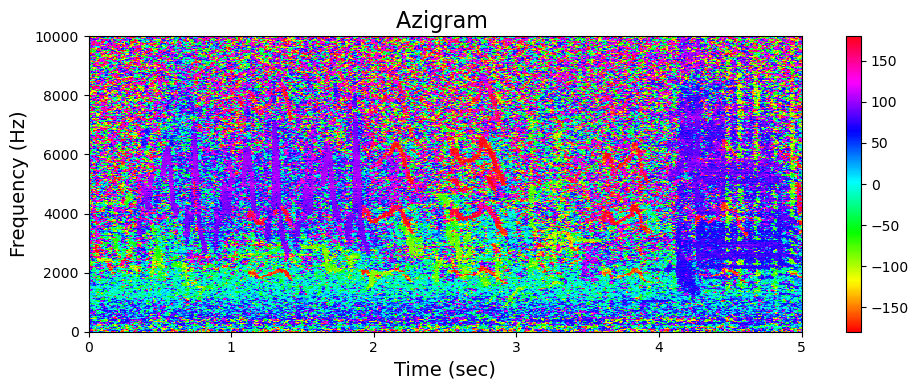

In [81]:
plotAzigram(inds, w_freqs, azimuth)

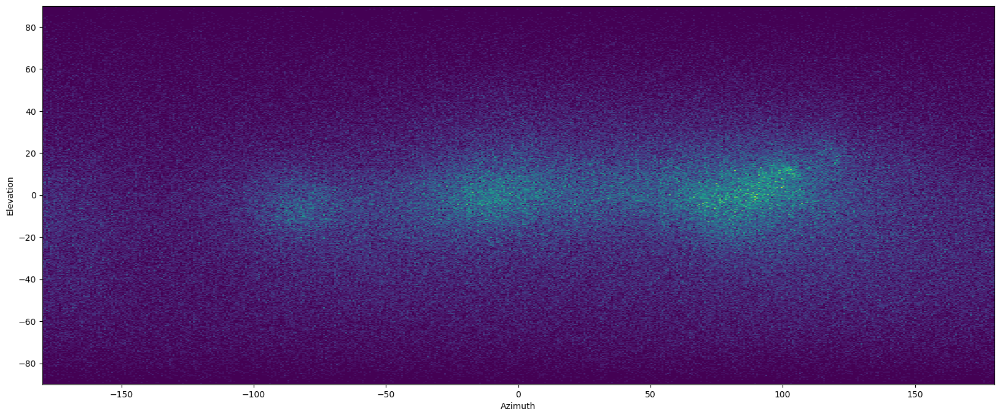

In [82]:
elevation = generateElevation(intensity[0], intensity[1], intensity[2])

plotElevationAgainstAzigram(elevation, azimuth)

In [83]:
def generate2dTime(inds, azimuth):

    time_2d = np.repeat(inds[:, np.newaxis], azimuth.shape[1], axis=1)
    return time_2d


In [84]:

def plotAzimuthAgainstTime(inds, azimuth):
    # plt.figure(figsize = (10,4))

    time_2d = generate2dTime(inds, azimuth)
    plt.hist2d(time_2d.ravel(), azimuth.ravel(), bins = 512)

    plt.xlim([0, 15])
    plt.ylim([-180, 180])

    plt.xlabel("Time (seconds)")
    plt.ylabel("Azimuth (degrees)")

    plt.title("Azimuth Against Time", fontsize = 14)

    # plt.tight_layout()
    # plt.show()

In [85]:
def plotElevationAgainstTime(inds, elevation):
    # plt.figure(figsize = (10,4))

    time_2d = generate2dTime(inds, elevation)
    plt.hist2d(time_2d.ravel(), elevation.ravel(), bins = 512)

    plt.xlim([0, 15])
    plt.ylim([-90, 90])

    plt.xlabel("Time (seconds)")
    plt.ylabel("Elevation (degrees)")

    plt.title("Elevation Against Time", fontsize = 14)

    # plt.tight_layout()
    # plt.show()

In [86]:
def plotAzimuthAgainstFreq(freqs, azimuth):
    # plt.figure(figsize = (10, 4))

    freqs = np.repeat(freqs[:, np.newaxis], azimuth.shape[0], axis=0)
    plt.hist2d(freqs.ravel(), azimuth.ravel(), bins = 512)

    plt.xlabel("Frequency (Hz)")
    plt.ylabel("Azimuth (degrees)")

    plt.title("Azimuth against Frequency", fontsize = 14)

    # plt.tight_layout()
    # plt.show()


In [87]:
def plotElevationAgainstFreq(freqs, elevation):
    # plt.figure(figsize = (10, 4))

    freqs = np.repeat(freqs[:, np.newaxis], elevation.shape[0], axis=0)
    plt.hist2d(freqs.ravel(), elevation.ravel(), bins = 512)

    plt.xlabel("Frequency (Hz)")
    plt.ylabel("Elevation (degrees)")

    plt.title("Elevation against Frequency", fontsize = 14)

    # plt.tight_layout()
    # plt.show()


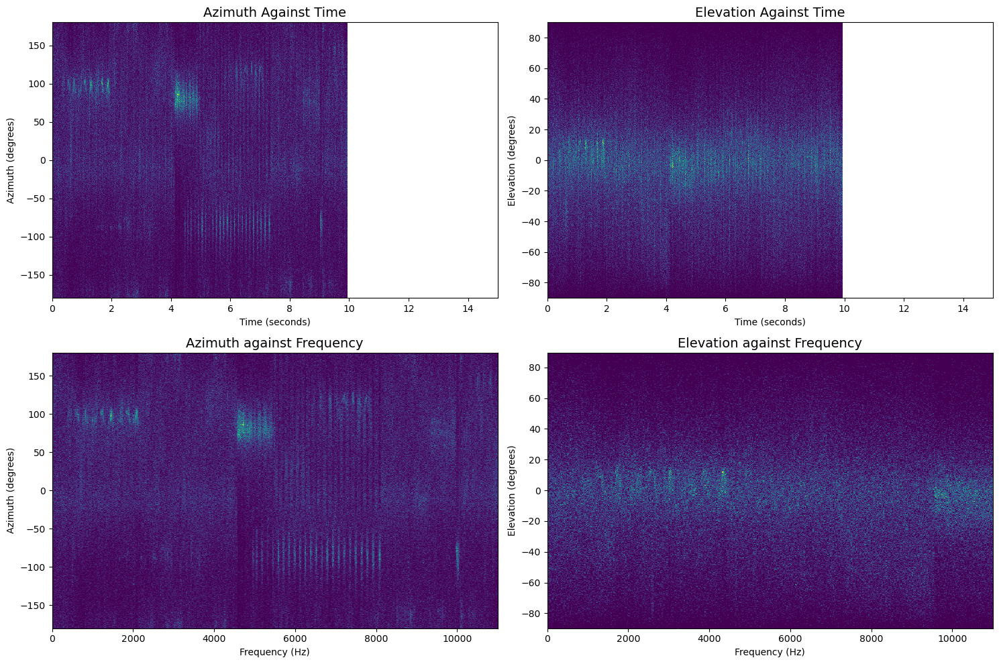

In [88]:
plt.figure(figsize = (15, 10))
plt.subplot(2,2,1)
plotAzimuthAgainstTime(inds, azimuth)
plt.subplot(2,2,2)
plotElevationAgainstTime(inds, elevation)
plt.subplot(2,2,3)
plotAzimuthAgainstFreq(freqs, azimuth)
plt.subplot(2,2,4)
plotElevationAgainstFreq(freqs, elevation[:512])
plt.tight_layout()
plt.show()

In [89]:
def plotElevation(inds, freqs, elevation):

    plt.figure(figsize = (10, 4))


    plt.pcolormesh(inds, freqs, elevation.T, cmap='hsv', vmin=-10)
    plt.xlabel('Time (sec)', fontsize=14)
    plt.ylabel('Frequency (Hz)', fontsize=14)
    plt.title("Elevation ", fontsize=16)
    plt.ylim([0, 10000])
    plt.xlim([0, 5])
    plt.colorbar()

    plt.tight_layout()
    plt.show()

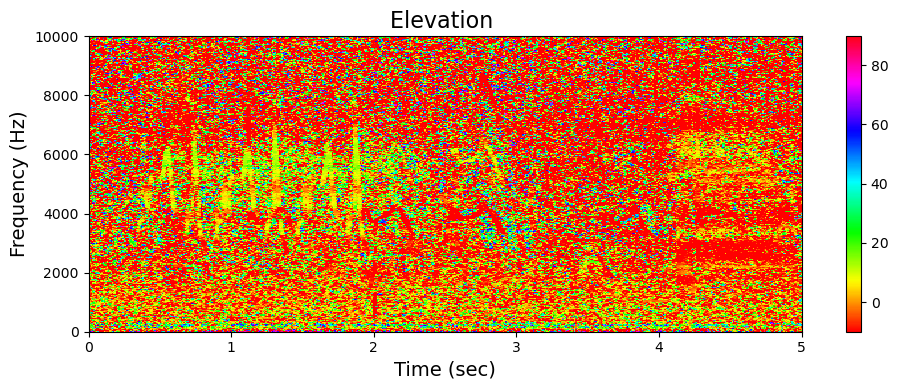

In [90]:
plotElevation(inds, w_freqs, elevation)

In [91]:
def sumAzimuth(azimuth, p_component):

    plt.figure(figsize = (10, 4))

    plt.hist(azimuth.ravel(), bins = 360, weights = p_component.ravel())
    plt.xlabel("Azimuth")
    plt.title("Histogram of Azimuth")



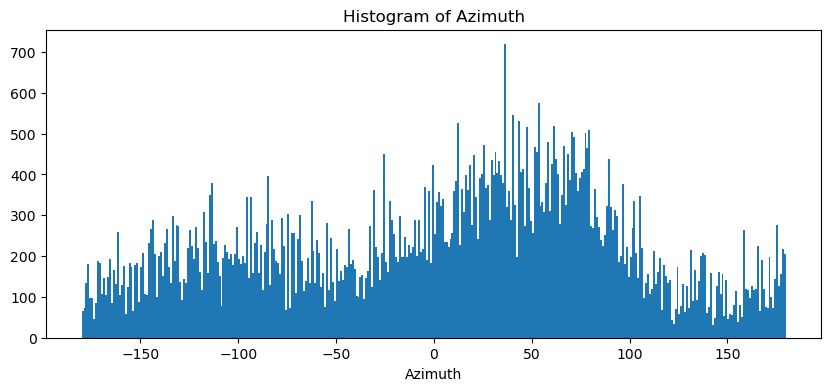

In [92]:

sumAzimuth(azimuth, p_component)

In [93]:
def sumElevation(elevation, p_component):

    plt.figure(figsize = (10, 4))

    plt.hist(elevation.ravel(), bins = 180, weights = p_component.ravel())
    plt.xlabel("Elevation")
    plt.title("Histogram of Elevation")

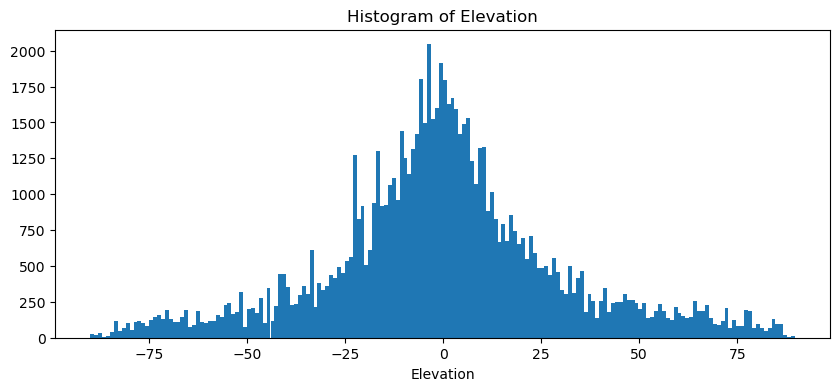

In [94]:
sumElevation(elevation, p_component)

In [3]:
def butter_bandpass_filter(data, cut, fs, btype='bandpass', order=5):
    nyq = 0.5 * fs
    cutoff = cut / nyq
    b, a = butter(order, cutoff, btype=btype, analog=False)
    y = filtfilt(b, a, data)
    return y

In [10]:
filtered_signals = butter_bandpass_filter(signal, np.array([2000, 6000]), sampling_rate)



In [11]:
print(filtered_signals)

[-6.47677874e-16  3.49190625e-14  1.45828217e-13 ... -4.60789725e-05
 -4.09226827e-05 -1.76869884e-06]


In [6]:
[inds, filtered_freqs, filtered_spectrogram] = makeSpectrogram(filtered_signals[0], sampling_rate)

NameError: name 'makeSpectrogram' is not defined

In [12]:
display(Audio(filtered_signals, rate = sampling_rate))
display(Audio(signal, rate = sampling_rate))

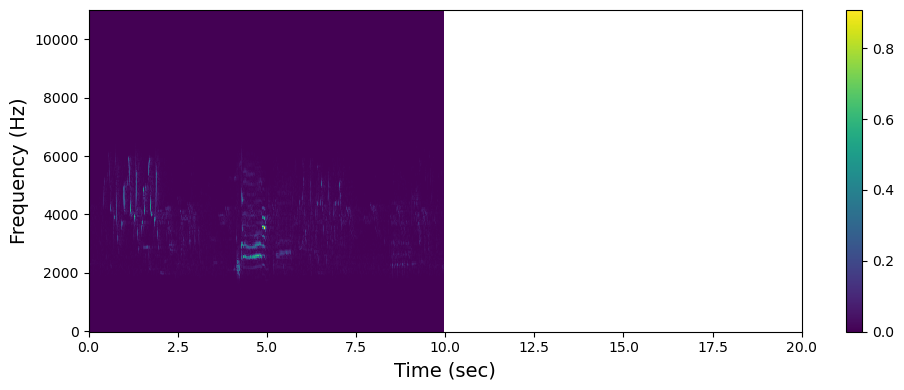

In [100]:
plt.figure(figsize = (10, 4))
plt.pcolormesh(inds, filtered_freqs, np.abs(filtered_spectrogram).T)
plt.xlabel('Time (sec)', fontsize=14)
plt.ylabel('Frequency (Hz)', fontsize=14)
plt.xlim([0, 20])
plt.colorbar()

plt.tight_layout()
plt.show()

In [13]:
print(filtered_signals.shape)
wavfile.write("animals_filtered.wav", sampling_rate, filtered_signals.T.astype(np.float32))

(439354,)
